In [1]:
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import pandas as pd
import glob
from adjustText import adjust_text
import json
from matplotlib import pylab as plt
import numpy as np
import pandas as pd
import pickle
import random
from random import seed, shuffle
import re
from sklearn.feature_extraction import text
import string
import seaborn as sns
from tqdm import tqdm
#Gensim
import gensim
import gensim.corpora as corpora
from gensim.utils import simple_preprocess
from gensim.models import CoherenceModel
from gensim.models import TfidfModel
from gensim.models import Word2Vec
from gensim.models.callbacks import CallbackAny2Vec
from gensim.models import KeyedVectors
#spacy
import spacy
from nltk.corpus import stopwords
#nltk
import nltk
from nltk import pos_tag
nltk.download('averaged_perceptron_tagger')
nltk.download('punkt')
from nltk.tokenize import sent_tokenize
from nltk.tokenize import word_tokenize
from nltk.tokenize.treebank import TreebankWordDetokenizer
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS
from sklearn.feature_extraction import text
from nltk.stem import WordNetLemmatizer
# disable warnings
pd.options.mode.chained_assignment = None  # default='warn'

import logging
logging.basicConfig(format='%(asctime)s : %(levelname)s : %(message)s', level=logging.INFO)

/Users/melodysepahpour/miniforge3/envs/mlp/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/melodysepahpour/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package punkt to
[nltk_data]     /Users/melodysepahpour/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


# PRE-PROCESSING

In [4]:
# functions to be used
#remove deleted comments and autmoderator comments
def remove_deleted_automod(data): 
    new_data = data.copy()
    new_data = data[data["author"] != "[deleted]"]
    new_data = new_data[new_data["author"] != "AutoModerator"]
    new_data.dropna(inplace = True)
    return new_data

#remove common authors
def remove_authors(data, authors_to_keep):
    new_data = data.copy()
    new_data = new_data.loc[new_data['author'].isin(authors_to_keep)]
    new_data = new_data.reset_index(drop=True)
    return new_data
    
# first round of text cleaning techniques
def clean_text_round1(text):
    '''Make text lowercase, remove text in square brackets, remove punctuation and remove words containing numbers.'''
    text = text.lower()
    text = re.sub('\[.*?\]', '', text)
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\w*\d\w*', '', text)
    text = re.sub("[^\u0000-\u05C0\u2100-\u214F]+",'', text)
    return text

# second round of cleaning
def clean_text_round2(text):
    '''Get rid of some additional punctuation and non-sensical text that was missed the first time around.'''
    text = re.sub('[‘’“”…]', '', text)
    text = re.sub('\n', '', text)
    return text

round2 = lambda x: clean_text_round2(x)

round1 = lambda x: clean_text_round1(x)
    
def gen_words(texts):
    """ process each document/text in texts"""
    data_words = []
    for text in texts:
        new = gensim.utils.simple_preprocess(text, deacc=True)
        data_words.append(new)
    return (data_words)

# functions to turn data into ngrams
def make_bigrams_trigrams(data_words, min_count=50, threshold=10):
    """First makes bigrams, then makes trigrams
    """
    #data_words = [doc.split(" ") for doc in data_words]
    bigram_phrases = gensim.models.Phrases(data_words, min_count=min_count, threshold=threshold)
    trigram_phrases = gensim.models.Phrases(bigram_phrases[data_words], threshold=threshold)
    fourgram_phrases = gensim.models.Phrases(trigram_phrases[data_words], threshold=threshold)
    
    bigram = gensim.models.phrases.Phraser(bigram_phrases)
    trigram = gensim.models.phrases.Phraser(trigram_phrases)
    fourgram = gensim.models.phrases.Phraser(fourgram_phrases)
    
    data_bigrams = [bigram[doc] for doc in data_words]
    # to trigrams we pass data_brigrams
    data_bigrams_trigrams = [trigram[bigram[doc]] for doc in data_bigrams]
    data_bigrams_trigrams_fourgams = [fourgram[trigram[bigram[doc]]] for doc in data_bigrams_trigrams]

    return(data_bigrams_trigrams_fourgams)

#tokenize
def tokenize(text):
    tokens = word_tokenize(text)
    return tokens

#detokenize
def detokenize(text):
    notokens = TreebankWordDetokenizer().detokenize(text)
    return notokens

#lemmatise
lemmatizer = WordNetLemmatizer()
def lemmatize_text(text):
    return [lemmatizer.lemmatize(w) for w in text]

#remove links
def remove_links(text):
    all_text = []
    
    for i in range(len(text)): 
        tok_text = tokenize(text[i])
        full_text = []
        
        for j in range(len(tok_text)): 
            word = tok_text[j]
            if 'https' in word or 'http' in word or 'www' in word:
                continue
            else:
                full_text.append(word)
                
        full_text = TreebankWordDetokenizer().detokenize(full_text)
        all_text.append(full_text)
        
    return all_text

In [5]:
#set the path to the data
path_to_data = "data/"

#data
df_daddit = pd.read_excel(path_to_data + 'comments_daddit.xlsx', header=None, names=['author', 'body', 'created_utc', 'subreddit'])
df_parenting_fathers = pd.read_excel(path_to_data +'comments_parenting_dads.xlsx', header=None, names=['author', 'body', 'created_utc', 'subreddit'])
df_parenting_mothers = pd.read_excel(path_to_data + 'comments_parenting_moms.xlsx')
df_mommit = pd.read_excel(path_to_data +'comments_mommit.xlsx')

print("Raw data:\n", f"Nb of comments fathers on r/Daddit: {len(df_daddit)}\n",  
     f"Nb of comments fathers on r/Parenting: {len(df_parenting_fathers)}\n",
     f"Nb of comments mothers on r/Parenting: {len(df_parenting_mothers)}\n", 
     f"Nb of comments mothers on r/Mommit: {len(df_mommit)}")


Raw data:
 Nb of comments fathers on r/Daddit: 19204
 Nb of comments fathers on r/Parenting: 42979
 Nb of comments mothers on r/Parenting: 102487
 Nb of comments mothers on r/Mommit: 29827


In [6]:
#remove deleted comments and autmoderator comments
df_daddit, df_parenting_fathers, df_parenting_mothers, df_mommit = remove_deleted_automod(df_daddit), remove_deleted_automod(df_parenting_fathers), remove_deleted_automod(df_parenting_mothers),remove_deleted_automod(df_mommit)

print("Data after filtering deleted comments and comments written by the AutoModerator:\n", 
      f"Nb of comments fathers on r/Daddit: {len(df_daddit)}\n",  
      f"Nb of comments fathers on r/Parenting: {len(df_parenting_fathers)}\n",
      f"Nb of comments mothers on r/Parenting: {len(df_parenting_mothers)}\n", 
      f"Nb of comments mothers on r/Mommit: {len(df_mommit)}")

Data after filtering deleted comments and comments written by the AutoModerator:
 Nb of comments fathers on r/Daddit: 19204
 Nb of comments fathers on r/Parenting: 42979
 Nb of comments mothers on r/Parenting: 92193
 Nb of comments mothers on r/Mommit: 28056


In [7]:
#Remove common authors
common_authors = set(df_mommit["author"]).intersection(set(df_daddit["author"]))

authors_to_keep = []
for author in set(list(df_mommit["author"])+list(df_daddit["author"])): 
    if author not in common_authors:
        authors_to_keep.append(author)
        
df_daddit, df_parenting_fathers, df_parenting_mothers, df_mommit = remove_authors(df_daddit, authors_to_keep), remove_authors(df_parenting_fathers, authors_to_keep), remove_authors(df_parenting_mothers, authors_to_keep), remove_authors(df_mommit, authors_to_keep)

print("Data after removing common authors:\n", 
      f"Nb of comments fathers on r/Daddit: {len(df_daddit)}\n",  
      f"Nb of comments fathers on r/Parenting: {len(df_parenting_fathers)}\n",
      f"Nb of comments mothers on r/Parenting: {len(df_parenting_mothers)}\n", 
      f"Nb of comments mothers on r/Mommit: {len(df_mommit)}")

Data after removing common authors:
 Nb of comments fathers on r/Daddit: 16585
 Nb of comments fathers on r/Parenting: 29729
 Nb of comments mothers on r/Parenting: 78943
 Nb of comments mothers on r/Mommit: 24285


In [8]:
#add a suffix to usernames to differenciate users in different subreddits
df_daddit['author'] = df_daddit['author'].astype(str) + "_fd" #fd = fathers on daddit
df_parenting_fathers['author'] = df_parenting_fathers['author'].astype(str) + "_fp" #fd = fathers on parenting
df_mommit['author'] = df_mommit['author'].astype(str) + "_mm" #fd = fathers on daddit
df_parenting_mothers['author'] = df_parenting_mothers['author'].astype(str) + "_mp" #fd = fathers on daddit

In [9]:
#merge the dataset and add a column 'gender'
df_mothers = pd.concat([df_mommit, df_parenting_mothers], ignore_index = True)
df_fathers = pd.concat([df_daddit, df_parenting_fathers], ignore_index = True)
df_mothers['gender'] = 'mother'
df_fathers['gender'] = 'father'
df = pd.concat([df_mothers, df_fathers], ignore_index = True)
df.shape

(149542, 5)

In [10]:
#those words appear frequently with different spellings so we will replace them by a unique spelling
df["body"] = df["body"].str.replace('post partum','postpartum')
df["body"] = df["body"].str.replace('post-partum','postpartum')
df["body"] = df["body"].str.replace('breast feeding','breastfeeding')
df["body"] = df["body"].str.replace('breast-feeding','breastfeeding')

In [11]:
for i in range(0,len(df)):
    if "your submission has been removed" in df['body'][i].lower():
        print(df['body'][i])

Your submission has been removed for: 

**Your post was removed for violating the rule 1 - “Only Parents or Guardians May Post”.** 

Although everyone is welcome to *comment*, we only allow new threads from parents/guardians. As an alternative, please visit /r/AskParents or check out our weekly sticky Ask Parents Everything thread.



This is an automated message from your friendly neighborhood AutoMod. If you feel that this action was taken in error or would like additional information, please send us a [modmail](https://www.reddit.com/message/compose?to=%2Fr%2FParenting) with your question and a link to the removed content, and a human will get back to you as soon as possible.
Your submission has been removed for: 

**Your post or comment was removed for violating rule 6 - NO Surveys**

**Absolutely** no surveys in any way, shape, or form. This includes (but is not limited to) school/university research, marketing research, polls, interview requests, etc. The community has been very 

In [12]:
#remove the 'removed' comments
removed_indices = []
for i in range(0,len(df)):
    if "your submission has been removed" in df['body'][i].lower():
        removed_indices.append(i)
print(len(removed_indices))

df.drop(df.index[removed_indices], inplace = True)
df = df.reset_index(drop=True)

120


In [13]:
# Clean
df['cleaned'] = df['body'].copy()
df = df.dropna(subset=["cleaned"])

df['cleaned'] = df.cleaned.apply(round1)
df['cleaned'] = df.cleaned.apply(round2)
df['cleaned'] = remove_links(df['cleaned'])
df = df.reset_index(drop=True)

# Some nan may have risen from last clean, remove this ones too
print(len(df))

149422


In [14]:
#remove empty posts
df["cleaned"] = df["cleaned"].apply(tokenize)
empty_posts = 0
for post in df['cleaned']:
    if len(post) == 0:
        empty_posts += 1
print(empty_posts)
#remove empty comments
df = df[df.astype(str)['cleaned'] != "[]"]
#Reset the indexes
df = df.reset_index(drop=True)

518


In [15]:
#BIGRAMS TRIGRAMS
#store all comments in a list
text_data_all = []
for index, row in df.iterrows():
    text_data_all.append(row["cleaned"])

#create the ngram model
docs_bi_tri = make_bigrams_trigrams(text_data_all)

2023-08-21 12:09:01,877 : INFO : collecting all words and their counts
2023-08-21 12:09:01,878 : INFO : PROGRESS: at sentence #0, processed 0 words and 0 word types
2023-08-21 12:09:02,128 : INFO : PROGRESS: at sentence #10000, processed 446520 words and 177739 word types
2023-08-21 12:09:02,377 : INFO : PROGRESS: at sentence #20000, processed 882911 words and 290794 word types
2023-08-21 12:09:02,706 : INFO : PROGRESS: at sentence #30000, processed 1420894 words and 408486 word types
2023-08-21 12:09:03,075 : INFO : PROGRESS: at sentence #40000, processed 2027287 words and 524197 word types
2023-08-21 12:09:03,447 : INFO : PROGRESS: at sentence #50000, processed 2631187 words and 625613 word types
2023-08-21 12:09:03,843 : INFO : PROGRESS: at sentence #60000, processed 3244304 words and 722550 word types
2023-08-21 12:09:04,235 : INFO : PROGRESS: at sentence #70000, processed 3864111 words and 811697 word types
2023-08-21 12:09:04,608 : INFO : PROGRESS: at sentence #80000, processed 4

In [16]:
#number of ngrams after adding ngrams
bigrams_trigram = []
for doc in docs_bi_tri:
    for word in doc:
        if "_" in word and word not in bigrams_trigram:
            bigrams_trigram.append(word)
print("Number of bigrams", len(bigrams_trigram))

Number of bigrams 9132


In [17]:
#STOPWORDS
#add those stopwords
add_stop_words = ["ai", "im", "m", "s", "ve", "w", "d", "ive", "id", "itll", "shes", "hes", "theyre", "youre", "dont", "got", "havent", "didn"]
stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)
#remove stopwords from tokenized dataset
#docs_bi_tri_nostop = docs_bi_tri.copy()

#remove stopwords from tokenized dataset
docs_bi_tri_nostop = []
for doc in docs_bi_tri:
    doc_new = []
    for word in doc: 
        if word not in stop_words:
            doc_new.append(word)
    docs_bi_tri_nostop.append(doc_new)

In [18]:
#LEMMATIZATION
nltk.download('wordnet')
nltk.download('omw-1.4')

docs_bi_tri_nostop_lem = []
for doc in docs_bi_tri_nostop:
    docs_bi_tri_nostop_lem.append(lemmatize_text(doc))

[nltk_data] Downloading package wordnet to
[nltk_data]     /Users/melodysepahpour/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     /Users/melodysepahpour/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


22.365302476763553


/Users/melodysepahpour/miniforge3/envs/mlp/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


<AxesSubplot:ylabel='Density'>

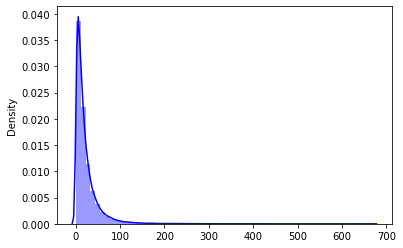

In [19]:
#get the mean length of comments
lengths = []
for doc in docs_bi_tri_nostop_lem: 
    lengths.append(len(doc))
    
print(np.mean(lengths))

sns.distplot(lengths, color="blue", bins=60)

In [20]:
#get the percentage of comments under a specified length (here, 30)
def percentageUndervalue(lengths, val):
    value = val
    underval = 0
    for number in lengths: 
        if number < value:
            underval += 1
    undervaluePercentage = (underval / len(lengths)) * 100
    return undervaluePercentage

print(percentageUndervalue(lengths, 30))

76.92540160103154


In [21]:
print(percentageUndervalue(lengths, 20))

62.80690914951915


In [22]:
#join the documents and put them in the column 'cleaned'
temp = [' '.join(doc) for doc in docs_bi_tri_nostop_lem]
df["cleaned"] = temp

In [23]:
#check again for empty comments and remove them
empty_posts = 0
for post in df['cleaned']:
    if len(post) == 0:
        empty_posts += 1
print(empty_posts)

#remove empty comments
df = df[df.astype(str)['cleaned'] != "[]"]
df = df[df.astype(str)['cleaned'] != ""]
df = df[df.astype(str)['author'] != "[]"]
#Reset the indexes
df = df.reset_index(drop=True)

600


In [24]:
#function to add the agent at a random position in the document. 
random.seed(0)

def rand_pos_agent(text, authors):
    full_list_r = []
    for i in range(len(text)):
        tok_text = text[i].split(" ")
        pos = random.randint(0, len(tok_text)-1)
        tok_text.insert(pos, "agent_"+authors[i])
        detok = ' '.join(tok_text)
        full_list_r.append(detok)
    return full_list_r

def middle_pos_agent(text, authors):
    full_list_r = []
    for i in range(len(text)):
        tok_text = text[i].split(" ")
        midpoint = len(tok_text)//2        # for 7 items, after the 3th
        tok_text = tok_text[0:midpoint] + ["agent_"+authors[i]] + tok_text[midpoint:]  
        detok = ' '.join(tok_text)
        full_list_r.append(detok)
    return full_list_r

In [25]:
#call the function and add the output in the column 'full_rand_agent'
df['full_rand_agent'] = rand_pos_agent(df['cleaned'], df['author'])
df['middle_pos_agent'] = middle_pos_agent(df['cleaned'], df['author'])

In [26]:
#save the dataset in a text file
df.to_csv(path_to_data + 'middle_agent_parenting_reddit.txt', columns=["middle_pos_agent"], header=False, index=False)

# TRAIN THE WORD EMBEDDING

In [2]:
# By changing these seeds, randomness in the loading and training process
# will produce a different embedding each time

data_seed = 0 
model_seed = 0

In [3]:
# This class is needed to print out the loss during training, which can be useful to monitor
# the convergence behaviour: if the loss decreases significantly between two epochs, the 
# model may not be fully trained yet.

class PrintLoss(CallbackAny2Vec):
    """Callback to print loss after each epoch.
    Credits https://stackoverflow.com/questions/54888490/gensim-word2vec-print-log-loss
    """

    def __init__(self):
        self.epoch = 1
        self.loss_to_be_subed = 0
        self.log = ""

    def on_epoch_end(self, model):
        loss = model.get_latest_training_loss()
        loss_now = loss - self.loss_to_be_subed
        self.loss_to_be_subed = loss
        print('Loss after epoch {}: {}'.format(self.epoch, loss_now))
        self.log += 'Loss after epoch {}: {} \n'.format(self.epoch, loss_now)
        self.epoch += 1

In [4]:
# This class is a generator object. Each time it is called it returns a new line (i.e. data sample)
# from the file stored under "path_to_data". Most of the logic is a trick to perform pseudo-randomisation for large 
# input files.

class DataGenerator(object):
    def __init__(self, path_to_data,
                 share_data=1.,
                 chunk_size=10000,
                 random_buffer_size=100000,
                 data_seed=data_seed):
        
        """Iterator that loads lines from a (possibly large) file in a mildly randomised fashion. 
        
        We want to feed the data randomly to avoid training to depend on the order of the quotes in the 
        file. However, true randomisation is very costly when text files become larger than a few GB.
        
        Here, a buffer stores a set of lines from the text file. The buffer is shuffled, and the first chunk 
        of lines is returned (that is, one such line is yielded each time the generator is called). The buffer 
        is filled up again with fresh lines and shuffled. This continues until no lines are left to fill the 
        buffer with, at which point the remaining lines are returned.
        
        Args:
            path_to_data (str): Full path to a data file with one preprocessed sentence/document per line.
            share_of_original_data (float):  and picks each line with probability share_of_original_data, which
                effectively results in a dataset with approx n_data*share_of_original_data samples
            chunk_size (int): Return so many lines from the random buffer at once before filling it up again. Larger
                chunk sizes speed up training, but decrease randomness.
            random_buffer_size (int): Keep so many lines from the data file in a buffer which is shuffled before
                returning the samples in a chunk. Higher values take more RAM but lead to more randomness
                when sampling the data. A value equal to the number of all samples would lead to perfectly
                random samples.
        """
        if chunk_size > random_buffer_size:
            raise ValueError("Chunk size cannot be larger than the buffer size.")

        self.path_to_data = path_to_data
        self.share_of_original_data = share_data
        self.chunk_size = chunk_size
        self.random_buffer_size = random_buffer_size
        seed(data_seed)

    def __iter__(self):

        # load initial buffer
        buffer = []
        with open(self.path_to_data, "r") as f:

            reached_end = False

            # fill buffer for the first time
            for i in range(self.random_buffer_size):
                line = f.readline().strip().split(" ")
                if not line:
                    reached_end = True
                    break
                buffer.append(line)

            while not reached_end:

                # randomise the buffer
                shuffle(buffer)

                # remove and return chunk from buffer
                for i in range(self.chunk_size):
                    # separate non-bootstrap case here for speed
                    if self.share_of_original_data == 1.0:
                        yield buffer.pop(0)
                    else:
                        # randomly decide whether this line is in
                        # the bootstrapped data
                        if np.random.rand() > self.share_of_original_data:
                            # remove anyways
                            buffer.pop(0)
                            continue
                        else:
                            yield buffer.pop(0)

                # fill up the buffer with a fresh chunk
                for i in range(self.chunk_size):
                    line = f.readline()
                    if not line:
                        reached_end = True
                        break
                    else:
                        buffer.append(line.strip().split(" "))

            # if end of file has been reached
            # yield all elements left in the buffer
            # in random order
            shuffle(buffer)
            for el in buffer:
                yield el

In [7]:
training_generator = DataGenerator("data/" + "middle_agent_parenting_reddit.txt")

In [8]:
model = Word2Vec(
    sentences = training_generator, 
    vector_size = 200, # number of dimensions that the word vectors will have
    window = 15,  # maximum distance between the current and predicted word
    sg = 1,  # use skip-gram (semantic learning) as training algorithm
    workers = 8,  # number of threads for training the model
    min_count = 5,  # ignores all words with total frequency lower than this  # CHANGE BACK TO 5 
    sorted_vocab = 1, # sort the words in the resulting embedding
    seed = model_seed, # use a random seed for reproducability
    epochs = 14,  # number of times training goes through the data
    compute_loss = True, # print the loss in each epoch
    callbacks = [PrintLoss()])
                                   
# normalise the word vectors
model.wv.init_sims()

# extract and save embedding
emb = model.wv
emb.save("middle_agent_parenting_reddit_embedding.emb")

2023-09-04 22:53:26,717 : INFO : collecting all words and their counts
2023-09-04 22:53:27,071 : INFO : PROGRESS: at sentence #0, processed 0 words, keeping 0 word types
2023-09-04 22:53:27,303 : INFO : PROGRESS: at sentence #10000, processed 232887 words, keeping 26279 word types
2023-09-04 22:53:27,542 : INFO : PROGRESS: at sentence #20000, processed 456437 words, keeping 37758 word types
2023-09-04 22:53:27,780 : INFO : PROGRESS: at sentence #30000, processed 677745 words, keeping 46788 word types
2023-09-04 22:53:28,028 : INFO : PROGRESS: at sentence #40000, processed 903455 words, keeping 54788 word types
2023-09-04 22:53:28,262 : INFO : PROGRESS: at sentence #50000, processed 1137279 words, keeping 62344 word types
2023-09-04 22:53:28,292 : INFO : PROGRESS: at sentence #60000, processed 1382507 words, keeping 69415 word types
2023-09-04 22:53:28,324 : INFO : PROGRESS: at sentence #70000, processed 1619359 words, keeping 75761 word types
2023-09-04 22:53:28,357 : INFO : PROGRESS: 

Loss after epoch 1: 10564185.0


2023-09-04 22:53:40,907 : INFO : EPOCH 1 - PROGRESS: at 4.66% examples, 135527 words/s, in_qsize 13, out_qsize 3
2023-09-04 22:53:41,940 : INFO : EPOCH 1 - PROGRESS: at 14.73% examples, 215412 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:42,981 : INFO : EPOCH 1 - PROGRESS: at 23.75% examples, 230225 words/s, in_qsize 7, out_qsize 0
2023-09-04 22:53:44,023 : INFO : EPOCH 1 - PROGRESS: at 32.39% examples, 237489 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:45,028 : INFO : EPOCH 1 - PROGRESS: at 43.14% examples, 257377 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:46,030 : INFO : EPOCH 1 - PROGRESS: at 52.45% examples, 263617 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:47,135 : INFO : EPOCH 1 - PROGRESS: at 63.03% examples, 269302 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:48,207 : INFO : EPOCH 1 - PROGRESS: at 73.46% examples, 274495 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:49,226 : INFO : EPOCH 1 - PROGRESS: at 84.44% examples, 282024 words/s, i

Loss after epoch 2: 8213877.0


2023-09-04 22:53:51,814 : INFO : EPOCH 2 - PROGRESS: at 4.66% examples, 140985 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:53:52,864 : INFO : EPOCH 2 - PROGRESS: at 14.70% examples, 217581 words/s, in_qsize 13, out_qsize 2
2023-09-04 22:53:53,920 : INFO : EPOCH 2 - PROGRESS: at 24.86% examples, 242218 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:54,937 : INFO : EPOCH 2 - PROGRESS: at 34.40% examples, 254591 words/s, in_qsize 15, out_qsize 1
2023-09-04 22:53:55,940 : INFO : EPOCH 2 - PROGRESS: at 43.11% examples, 259133 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:56,958 : INFO : EPOCH 2 - PROGRESS: at 54.24% examples, 273174 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:57,977 : INFO : EPOCH 2 - PROGRESS: at 64.33% examples, 279436 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:53:59,076 : INFO : EPOCH 2 - PROGRESS: at 74.96% examples, 283596 words/s, in_qsize 14, out_qsize 1
2023-09-04 22:54:00,083 : INFO : EPOCH 2 - PROGRESS: at 85.01% examples, 286729 words/s, 

Loss after epoch 3: 7200898.0


2023-09-04 22:54:02,666 : INFO : EPOCH 3 - PROGRESS: at 4.40% examples, 126744 words/s, in_qsize 16, out_qsize 1
2023-09-04 22:54:03,696 : INFO : EPOCH 3 - PROGRESS: at 14.85% examples, 215372 words/s, in_qsize 8, out_qsize 1
2023-09-04 22:54:04,714 : INFO : EPOCH 3 - PROGRESS: at 23.96% examples, 231882 words/s, in_qsize 3, out_qsize 2
2023-09-04 22:54:05,752 : INFO : EPOCH 3 - PROGRESS: at 34.63% examples, 254203 words/s, in_qsize 14, out_qsize 1
2023-09-04 22:54:06,766 : INFO : EPOCH 3 - PROGRESS: at 44.02% examples, 263453 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:07,769 : INFO : EPOCH 3 - PROGRESS: at 54.14% examples, 273066 words/s, in_qsize 16, out_qsize 1
2023-09-04 22:54:08,772 : INFO : EPOCH 3 - PROGRESS: at 64.59% examples, 281297 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:09,778 : INFO : EPOCH 3 - PROGRESS: at 75.13% examples, 287406 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:10,782 : INFO : EPOCH 3 - PROGRESS: at 84.20% examples, 287312 words/s, in

Loss after epoch 4: 7655264.0


2023-09-04 22:54:13,454 : INFO : EPOCH 4 - PROGRESS: at 4.34% examples, 130778 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:14,501 : INFO : EPOCH 4 - PROGRESS: at 14.44% examples, 212342 words/s, in_qsize 12, out_qsize 1
2023-09-04 22:54:15,598 : INFO : EPOCH 4 - PROGRESS: at 22.95% examples, 218342 words/s, in_qsize 16, out_qsize 1
2023-09-04 22:54:16,606 : INFO : EPOCH 4 - PROGRESS: at 31.91% examples, 232407 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:17,611 : INFO : EPOCH 4 - PROGRESS: at 42.47% examples, 251436 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:18,630 : INFO : EPOCH 4 - PROGRESS: at 52.40% examples, 260862 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:19,670 : INFO : EPOCH 4 - PROGRESS: at 61.51% examples, 263114 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:20,675 : INFO : EPOCH 4 - PROGRESS: at 71.08% examples, 269214 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:21,688 : INFO : EPOCH 4 - PROGRESS: at 79.51% examples, 268899 words/s, 

Loss after epoch 5: 4351024.0


2023-09-04 22:54:24,851 : INFO : EPOCH 5 - PROGRESS: at 5.50% examples, 169848 words/s, in_qsize 13, out_qsize 1
2023-09-04 22:54:25,859 : INFO : EPOCH 5 - PROGRESS: at 14.19% examples, 214758 words/s, in_qsize 11, out_qsize 0
2023-09-04 22:54:26,871 : INFO : EPOCH 5 - PROGRESS: at 23.63% examples, 235374 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:27,915 : INFO : EPOCH 5 - PROGRESS: at 31.29% examples, 232604 words/s, in_qsize 14, out_qsize 1
2023-09-04 22:54:28,939 : INFO : EPOCH 5 - PROGRESS: at 42.09% examples, 252791 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:30,029 : INFO : EPOCH 5 - PROGRESS: at 51.78% examples, 257778 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:31,060 : INFO : EPOCH 5 - PROGRESS: at 60.79% examples, 260853 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:32,073 : INFO : EPOCH 5 - PROGRESS: at 70.68% examples, 266959 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:33,076 : INFO : EPOCH 5 - PROGRESS: at 79.13% examples, 267192 words/s, 

Loss after epoch 6: 4245344.0


2023-09-04 22:54:36,515 : INFO : EPOCH 6 - PROGRESS: at 3.51% examples, 106559 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:37,526 : INFO : EPOCH 6 - PROGRESS: at 11.40% examples, 173641 words/s, in_qsize 14, out_qsize 1
2023-09-04 22:54:38,665 : INFO : EPOCH 6 - PROGRESS: at 21.53% examples, 205172 words/s, in_qsize 13, out_qsize 2
2023-09-04 22:54:39,702 : INFO : EPOCH 6 - PROGRESS: at 30.66% examples, 220835 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:40,729 : INFO : EPOCH 6 - PROGRESS: at 40.26% examples, 235944 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:54:41,742 : INFO : EPOCH 6 - PROGRESS: at 47.72% examples, 236567 words/s, in_qsize 15, out_qsize 1
2023-09-04 22:54:42,751 : INFO : EPOCH 6 - PROGRESS: at 57.94% examples, 248251 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:43,757 : INFO : EPOCH 6 - PROGRESS: at 67.30% examples, 253944 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:44,813 : INFO : EPOCH 6 - PROGRESS: at 75.21% examples, 252197 words/s, 

Loss after epoch 7: 4084528.0


2023-09-04 22:54:48,762 : INFO : EPOCH 7 - PROGRESS: at 3.23% examples, 94515 words/s, in_qsize 13, out_qsize 1
2023-09-04 22:54:49,827 : INFO : EPOCH 7 - PROGRESS: at 12.62% examples, 183629 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:50,888 : INFO : EPOCH 7 - PROGRESS: at 19.99% examples, 190310 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:51,932 : INFO : EPOCH 7 - PROGRESS: at 29.18% examples, 209362 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:52,938 : INFO : EPOCH 7 - PROGRESS: at 36.90% examples, 215564 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:54:54,093 : INFO : EPOCH 7 - PROGRESS: at 45.27% examples, 218869 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:54:55,096 : INFO : EPOCH 7 - PROGRESS: at 53.09% examples, 223240 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:54:56,099 : INFO : EPOCH 7 - PROGRESS: at 62.78% examples, 232996 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:54:57,104 : INFO : EPOCH 7 - PROGRESS: at 71.43% examples, 237710 words/s, i

Loss after epoch 8: 4168488.0


2023-09-04 22:55:01,616 : INFO : EPOCH 8 - PROGRESS: at 4.08% examples, 126493 words/s, in_qsize 13, out_qsize 0
2023-09-04 22:55:02,626 : INFO : EPOCH 8 - PROGRESS: at 11.09% examples, 170731 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:03,681 : INFO : EPOCH 8 - PROGRESS: at 19.83% examples, 197251 words/s, in_qsize 14, out_qsize 1
2023-09-04 22:55:04,738 : INFO : EPOCH 8 - PROGRESS: at 27.08% examples, 199096 words/s, in_qsize 13, out_qsize 1
2023-09-04 22:55:05,786 : INFO : EPOCH 8 - PROGRESS: at 36.25% examples, 214448 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:06,814 : INFO : EPOCH 8 - PROGRESS: at 44.18% examples, 219479 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:07,832 : INFO : EPOCH 8 - PROGRESS: at 51.29% examples, 219691 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:08,846 : INFO : EPOCH 8 - PROGRESS: at 59.49% examples, 224307 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:09,930 : INFO : EPOCH 8 - PROGRESS: at 67.05% examples, 224311 words/s, 

Loss after epoch 9: 3863752.0


2023-09-04 22:55:15,112 : INFO : EPOCH 9 - PROGRESS: at 3.16% examples, 98479 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:16,135 : INFO : EPOCH 9 - PROGRESS: at 10.55% examples, 159976 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:17,259 : INFO : EPOCH 9 - PROGRESS: at 17.78% examples, 171686 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:18,295 : INFO : EPOCH 9 - PROGRESS: at 25.93% examples, 187383 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:19,304 : INFO : EPOCH 9 - PROGRESS: at 33.14% examples, 194361 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:20,305 : INFO : EPOCH 9 - PROGRESS: at 41.37% examples, 205031 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:21,325 : INFO : EPOCH 9 - PROGRESS: at 50.44% examples, 215930 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:22,344 : INFO : EPOCH 9 - PROGRESS: at 57.41% examples, 216516 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:23,362 : INFO : EPOCH 9 - PROGRESS: at 66.21% examples, 222799 words/s, i

Loss after epoch 10: 3796204.0


2023-09-04 22:55:29,229 : INFO : EPOCH 10 - PROGRESS: at 3.16% examples, 97151 words/s, in_qsize 12, out_qsize 0
2023-09-04 22:55:30,250 : INFO : EPOCH 10 - PROGRESS: at 10.41% examples, 159097 words/s, in_qsize 14, out_qsize 1
2023-09-04 22:55:31,266 : INFO : EPOCH 10 - PROGRESS: at 18.89% examples, 188803 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:55:32,330 : INFO : EPOCH 10 - PROGRESS: at 27.92% examples, 205622 words/s, in_qsize 12, out_qsize 0
2023-09-04 22:55:33,342 : INFO : EPOCH 10 - PROGRESS: at 35.67% examples, 212539 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:34,355 : INFO : EPOCH 10 - PROGRESS: at 44.89% examples, 225763 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:35,388 : INFO : EPOCH 10 - PROGRESS: at 53.01% examples, 229605 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:36,410 : INFO : EPOCH 10 - PROGRESS: at 62.13% examples, 236098 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:37,423 : INFO : EPOCH 10 - PROGRESS: at 70.87% examples, 240336 w

Loss after epoch 11: 3680604.0


2023-09-04 22:55:41,900 : INFO : EPOCH 11 - PROGRESS: at 4.08% examples, 121482 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:42,927 : INFO : EPOCH 11 - PROGRESS: at 13.08% examples, 192133 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:43,957 : INFO : EPOCH 11 - PROGRESS: at 20.78% examples, 201058 words/s, in_qsize 11, out_qsize 1
2023-09-04 22:55:44,980 : INFO : EPOCH 11 - PROGRESS: at 30.31% examples, 221047 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:46,032 : INFO : EPOCH 11 - PROGRESS: at 39.67% examples, 233565 words/s, in_qsize 14, out_qsize 1
2023-09-04 22:55:47,043 : INFO : EPOCH 11 - PROGRESS: at 47.80% examples, 237506 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:48,060 : INFO : EPOCH 11 - PROGRESS: at 56.78% examples, 243855 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:55:49,082 : INFO : EPOCH 11 - PROGRESS: at 64.01% examples, 241971 words/s, in_qsize 16, out_qsize 1
2023-09-04 22:55:50,106 : INFO : EPOCH 11 - PROGRESS: at 73.27% examples, 247272 

Loss after epoch 12: 3724144.0


2023-09-04 22:55:54,179 : INFO : EPOCH 12 - PROGRESS: at 4.19% examples, 126540 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:55,224 : INFO : EPOCH 12 - PROGRESS: at 12.68% examples, 190084 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:55:56,291 : INFO : EPOCH 12 - PROGRESS: at 21.47% examples, 208899 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:57,336 : INFO : EPOCH 12 - PROGRESS: at 29.62% examples, 216983 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:58,348 : INFO : EPOCH 12 - PROGRESS: at 38.75% examples, 230258 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:55:59,364 : INFO : EPOCH 12 - PROGRESS: at 46.71% examples, 233154 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:56:00,400 : INFO : EPOCH 12 - PROGRESS: at 54.09% examples, 232116 words/s, in_qsize 15, out_qsize 1
2023-09-04 22:56:01,404 : INFO : EPOCH 12 - PROGRESS: at 62.62% examples, 236614 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:56:02,404 : INFO : EPOCH 12 - PROGRESS: at 71.32% examples, 241196 

Loss after epoch 13: 1597824.0


2023-09-04 22:56:06,998 : INFO : EPOCH 13 - PROGRESS: at 4.05% examples, 123596 words/s, in_qsize 9, out_qsize 0
2023-09-04 22:56:08,018 : INFO : EPOCH 13 - PROGRESS: at 11.82% examples, 176806 words/s, in_qsize 11, out_qsize 0
2023-09-04 22:56:09,044 : INFO : EPOCH 13 - PROGRESS: at 19.08% examples, 188240 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:56:10,045 : INFO : EPOCH 13 - PROGRESS: at 27.52% examples, 203973 words/s, in_qsize 13, out_qsize 0
2023-09-04 22:56:11,092 : INFO : EPOCH 13 - PROGRESS: at 35.85% examples, 213284 words/s, in_qsize 16, out_qsize 0
2023-09-04 22:56:12,123 : INFO : EPOCH 13 - PROGRESS: at 44.53% examples, 222914 words/s, in_qsize 14, out_qsize 1
2023-09-04 22:56:13,139 : INFO : EPOCH 13 - PROGRESS: at 52.38% examples, 226471 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:56:14,165 : INFO : EPOCH 13 - PROGRESS: at 61.01% examples, 231067 words/s, in_qsize 15, out_qsize 0
2023-09-04 22:56:15,243 : INFO : EPOCH 13 - PROGRESS: at 69.67% examples, 233296 w

Loss after epoch 14: 60224.0


In [9]:
# load embedding
embedding_rand_agent = KeyedVectors.load('middle_agent_parenting_reddit_embedding.emb')

path_rand_pos = 'data/middle_agent_parenting_reddit.txt' 

data_rand_pos = {"agent":[],
                  "comments":[]}

with open(path_rand_pos, "r") as f:
    for line in f:
        l = line.strip().split(" ")
        agent = [word for word in l if "agent_" in word]
        if l:
            data_rand_pos["agent"].append(agent[0])
            data_rand_pos["comments"].append([" ".join(l)])

data_rand_pos = pd.DataFrame(data_rand_pos)


2023-09-04 22:56:19,128 : INFO : loading KeyedVectors object from middle_agent_parenting_reddit_embedding.emb
2023-09-04 22:56:19,139 : INFO : KeyedVectors lifecycle event {'fname': 'middle_agent_parenting_reddit_embedding.emb', 'datetime': '2023-09-04T22:56:19.139928', 'gensim': '4.2.0', 'python': '3.9.2 | packaged by conda-forge | (default, Feb 21 2021, 05:00:30) \n[Clang 11.0.1 ]', 'platform': 'macOS-13.5-arm64-arm-64bit', 'event': 'loaded'}


In [10]:
#this is to check the number of posts in each group
posts_mommit = 0
posts_daddit = 0
posts_parentmom = 0
posts_parentdad = 0
for i in range(len(data_rand_pos)):
    if data_rand_pos["agent"][i][-3:] == "_mm":
        posts_mommit += 1
    elif data_rand_pos["agent"][i][-3:] == "_mp":
        posts_parentmom += 1
    if data_rand_pos["agent"][i][-3:] == "_fd":
        posts_daddit += 1
    if data_rand_pos["agent"][i][-3:] == "_fp":
        posts_parentdad += 1
print(posts_mommit + posts_daddit + posts_parentmom + posts_parentdad)

print("posts_mommit: ", posts_mommit)
print("posts_daddit: ", posts_daddit)
print("posts_parentmom: ", posts_parentmom)
print("posts_parentdad: ", posts_parentdad)

148304
posts_mommit:  24035
posts_daddit:  16388
posts_parentmom:  78450
posts_parentdad:  29431


In [11]:
threshold_num_comments = 4

# merge rows that contain the same agent
data_rand_pos = data_rand_pos.groupby(["agent"], as_index=False).agg({'comments': 'sum'})
print("# agents in training set: ", len(data_rand_pos.index))

# only take agents with more than X tweets
sample_rand_pos = data_rand_pos[data_rand_pos.comments.map(len)>threshold_num_comments]
print("# agents with more than X comments: ", len(sample_rand_pos.index))

# add a column with vectors of agents
sample_rand_pos["vec"] = sample_rand_pos.apply(lambda row: embedding_rand_agent[row.agent], axis=1)
sample_rand_pos = sample_rand_pos.reset_index(drop=True)

#Only keep the intersection of parents
mommit = []
daddit = []
fat_parent = []
mot_parent = []

for i in range(len(sample_rand_pos)): 
    if sample_rand_pos["agent"][i][-2] == "m":
        if sample_rand_pos["agent"][i][-1] == "m" and sample_rand_pos["agent"][i][:-2] not in mommit:
            mommit.append(sample_rand_pos["agent"][i][:-2])
        elif sample_rand_pos["agent"][i][-1] == "p" and sample_rand_pos["agent"][i][:-2] not in mot_parent:
            mot_parent.append(sample_rand_pos["agent"][i][:-2])
    elif sample_rand_pos["agent"][i][-2] == "f":
        if sample_rand_pos["agent"][i][-1] == "d" and sample_rand_pos["agent"][i][:-2] not in daddit:
            daddit.append(sample_rand_pos["agent"][i][:-2])
        elif sample_rand_pos["agent"][i][-1] == "p" and sample_rand_pos["agent"][i][:-2] not in fat_parent:
            fat_parent.append(sample_rand_pos["agent"][i][:-2])

mom_to_keep = set(mommit).intersection(set(mot_parent))
dad_to_keep = set(daddit).intersection(set(fat_parent))

print(len(mom_to_keep))
print(len(dad_to_keep))

parents_to_keep = []

for i in range(len(sample_rand_pos)):
    if (sample_rand_pos["agent"][i][:-2] in mom_to_keep or sample_rand_pos["agent"][i][:-2] in dad_to_keep) and sample_rand_pos["agent"][i] not in parents_to_keep:
        parents_to_keep.append(sample_rand_pos["agent"][i])
    else:
        continue

print(len(parents_to_keep))
print(parents_to_keep[:10])
        
sample_rand_pos = sample_rand_pos.loc[sample_rand_pos['agent'].isin(parents_to_keep)]
len(sample_rand_pos)

# agents in training set:  15674
# agents with more than X comments:  5746
956
480
2872
['agent_-DontPanic42-_mm', 'agent_-DontPanic42-_mp', 'agent_-brownsherlock-_fd', 'agent_-brownsherlock-_fp', 'agent_3InaRow_mm', 'agent_3InaRow_mp', 'agent_415bjj_mm', 'agent_415bjj_mp', 'agent_4inAM_2atNoon_3inPM_mm', 'agent_4inAM_2atNoon_3inPM_mp']


2872

In [12]:
#add a column with the names of the 4 groups to sample_rand_pos
sample_rand_pos = sample_rand_pos.reset_index(drop=True)

list_groups = []
for i in range(len(sample_rand_pos)):
    if sample_rand_pos["agent"][i][-3:] == "_mm":
        list_groups.append("Mothers on r/Mommit")
    elif sample_rand_pos["agent"][i][-3:] == "_mp":
        list_groups.append("Mothers on r/Parenting")
    if sample_rand_pos["agent"][i][-3:] == "_fd":
        list_groups.append("Fathers on r/Daddit")
    if sample_rand_pos["agent"][i][-3:] == "_fp":
        list_groups.append("Fathers on r/Parenting")
print(len(list_groups))

sample_rand_pos["groups"] = list_groups

#number of users in each group who posted at least 5 comments on each subreddit
print("Mothers on r/Mommit: ",len(sample_rand_pos[sample_rand_pos["groups"]=="Mothers on r/Mommit"]))
print("Mothers on r/Parenting: ",len(sample_rand_pos[sample_rand_pos["groups"]=="Mothers on r/Parenting"]))
print("Fathers on r/Daddit: ",len(sample_rand_pos[sample_rand_pos["groups"]=="Fathers on r/Daddit"]))
print("Fathers on r/Parenting: ",len(sample_rand_pos[sample_rand_pos["groups"]=="Fathers on r/Parenting"]))

2872
Mothers on r/Mommit:  956
Mothers on r/Parenting:  956
Fathers on r/Daddit:  480
Fathers on r/Parenting:  480


In [14]:
#save the dataframe to pickle format
sample_rand_pos.to_pickle("data/" + "sample_middle_pos.pkl")

In [15]:
sample_rand_pos = pd.read_pickle("data/sample_middle_pos.pkl")

# SPEAKER-LANDSCAPES

In [16]:
#create a list with the colours for each group
colours_plot = ["mediumpurple", "lightcoral", "mediumaquamarine", "darkkhaki"]
markers_plot = ['o', 's', '^', 'p']  # Different markers for each group

colours = []
for i in range(len(sample_rand_pos)):
    if sample_rand_pos["groups"][i] == "Mothers on r/Mommit":
        colours.append(colours_plot[0])
    elif sample_rand_pos["groups"][i] == "Mothers on r/Parenting":
        colours.append(colours_plot[1])
    elif sample_rand_pos["groups"][i] == "Fathers on r/Daddit":
        colours.append(colours_plot[2])
    elif sample_rand_pos["groups"][i] == "Fathers on r/Parenting":
        colours.append(colours_plot[3])

markers = []
for i in range(len(sample_rand_pos)):
    if sample_rand_pos["groups"][i] == "Mothers on r/Mommit":
        markers.append(markers_plot[0])
    elif sample_rand_pos["groups"][i] == "Mothers on r/Parenting":
        markers.append(markers_plot[1])
    elif sample_rand_pos["groups"][i] == "Fathers on r/Daddit":
        markers.append(markers_plot[2])
    elif sample_rand_pos["groups"][i] == "Fathers on r/Parenting":
        markers.append(markers_plot[3])

print(len(colours))
print(len(markers))

2872
2872


In [17]:
#Topic model's keywords to be added in the landscape
topics_keywords = [
    "thank", "word", "thanks", "advice", "moment", "hug", 
    "doctor", "hospital", "anxiety", "pain", "risk", "health",
    "situation", "family", "relationship", "problem", "issue", "behavior",
    "room", "floor", "door", "house", "bathroom", "space", 
    "life", "love", "partner", "pregnancy", "heart", "birth",
    "diaper", "body", "sex",  "potty", "poop", "toilet", 
    "dog", "look", "face", "eye", "picture", "memory",
    "home", "car", "work", "house", "job", "money", 
    "food", "water", "meal", "milk", "snack", "dinner", 
    "book", "game", "play", "attention",  "activity", "fun", 
    "school", "teacher", "class", "daycare", "language","college", 
    "night", "bed", "sleep", "nap", "bedtime", "schedule"
]

#Set the colours of topics for the legend
col_topics = []
for i in range(len(topics_keywords)):
    if i<6:
        col_topics.append("cornflowerblue")
    elif i>=6 and i<12:
        col_topics.append("orange")
    elif i>=12 and i<18:
        col_topics.append("red")
    elif i>=18 and i<24:
        col_topics.append("peru")
    elif i>=24 and i<30:
        col_topics.append("pink")
    elif i>=30 and i<36:
        col_topics.append("silver")
    elif i>=36 and i<42:
        col_topics.append("cyan")
    elif i>=42 and i<48:
        col_topics.append("gold")
    elif i>=48 and i<54:
        col_topics.append("yellow")
    elif i>=54 and i<60:
        col_topics.append("indianred")
    elif i>=60 and i<66:
        col_topics.append("lime")
    elif i>=66 and i<72:
        col_topics.append("moccasin")
print(len(col_topics))

72


In [18]:
groups = ['Mothers on r/Mommit', 'Mothers on r/Parenting', 'Fathers on r/Daddit', 'Fathers on r/Parenting']
list_topics = ["Thank you/Appreciation", "Medical care", "Education/Family advice", "Furniture/Design", 
               "Birth/Pregnancy", "Change/Potty training", "Physical appearance/Picture", "Work/Raise children", 
               "Food", "Leisure activities", "School/Teaching", "Sleep training"]
all_labels = groups + list_topics

colours_plot_2 = ["mediumpurple", "lightcoral", "mediumaquamarine", "darkkhaki"] + ["cornflowerblue", "orange", "red", 
                                                                             "peru", "pink", "silver", "cyan", "gold",
                                                                             "yellow", "indianred", "lime", "moccasin"]

In [19]:
import umap.umap_ as umap
#reduce the 200d vectors into 2d vectors
reducer = umap.UMAP(metric="cosine", min_dist=0.1, n_neighbors=40, random_state=0)

In [20]:
sample_rand_pos.head()

,agent,comments,vec,groups
0,agent_-DontPanic42-_mm,[skin skin agent_-DontPanic42-_mm warm_bath pa...,"[0.19384123, -0.13443254, -0.2241744, -0.16615...",Mothers on r/Mommit
1,agent_-DontPanic42-_mp,[breastfed_babies poop formula_fed baby agent_...,"[0.5051444, -0.3562053, -0.29320413, 0.1169228...",Mothers on r/Parenting
2,agent_-brownsherlock-_fd,[month yearshe loved loved air slept atve time...,"[-0.0149084525, -0.44171926, 0.026177172, 0.10...",Fathers on r/Daddit
3,agent_-brownsherlock-_fp,[agree hugely ive_had hour fighting dealing_wi...,"[0.24692379, -0.42924577, 0.023512578, -0.0603...",Fathers on r/Parenting
4,agent_3InaRow_mm,[fine supervised fall_asleep leave baby agent_...,"[-0.020720175, -0.05927992, -0.102948904, 0.03...",Mothers on r/Mommit


In [21]:
# compute 2-d representation using UMAP
words_rand_pos = sample_rand_pos["agent"].tolist()
vecs_rand_pos = sample_rand_pos["vec"].tolist()
umap_res_rand_pos = reducer.fit_transform(vecs_rand_pos)

#for topics' keywords
annotations_keyword_rand_pos = [embedding_rand_agent[word] for word in topics_keywords]
ann_keyword_rand_pos = reducer.fit_transform(annotations_keyword_rand_pos)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [22]:
umap_res_rand_pos[:5]

array([[ 12.140447, -17.097733],
       [ 12.169081, -16.592913],
       [ 11.655728, -18.985754],
       [ 10.085726, -17.540672],
       [ 12.504351, -18.13193 ]], dtype=float32)

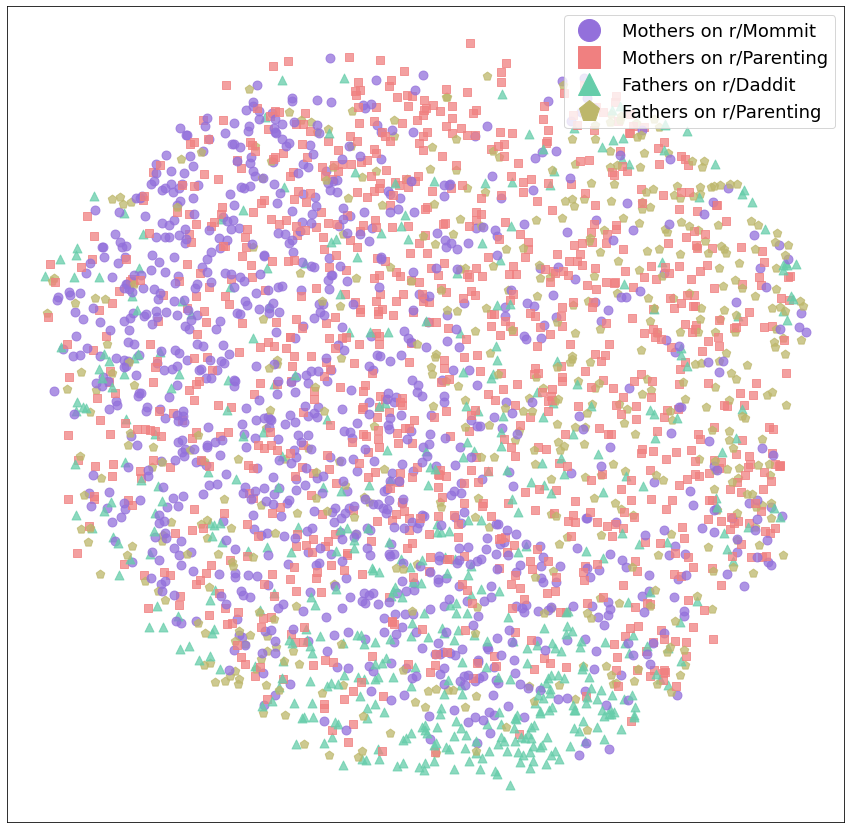

In [23]:
# Create a figure and axis
fig, ax = plt.subplots(1, 1, figsize=(15,15))

# Iterate through each color and marker combination
for i in range(len(umap_res_rand_pos)):
    ax.scatter(umap_res_rand_pos[i][0], umap_res_rand_pos[i][1], s=80, c=colours[i], marker=markers[i], alpha=0.75)

# Create custom legend items
custom_lines = []
for i in range(len(colours_plot)):
    custom_lines.append(Line2D([0], [0], marker=markers_plot[i], ls='', color=colours_plot[i], markersize=22))

# Add legend
ax.legend(custom_lines, ['Mothers on r/Mommit', 'Mothers on r/Parenting', 'Fathers on r/Daddit', 'Fathers on r/Parenting'],
          fontsize=15, loc="right", ncol=1, bbox_to_anchor=(1, 0.92), prop={'size': 18})

# Remove ticks and labels
plt.tick_params(
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False)

# Save and show the plot
plt.savefig("Figure1_speaker_landscape_agent_random.png", bbox_inches='tight', dpi=1200)
plt.show()

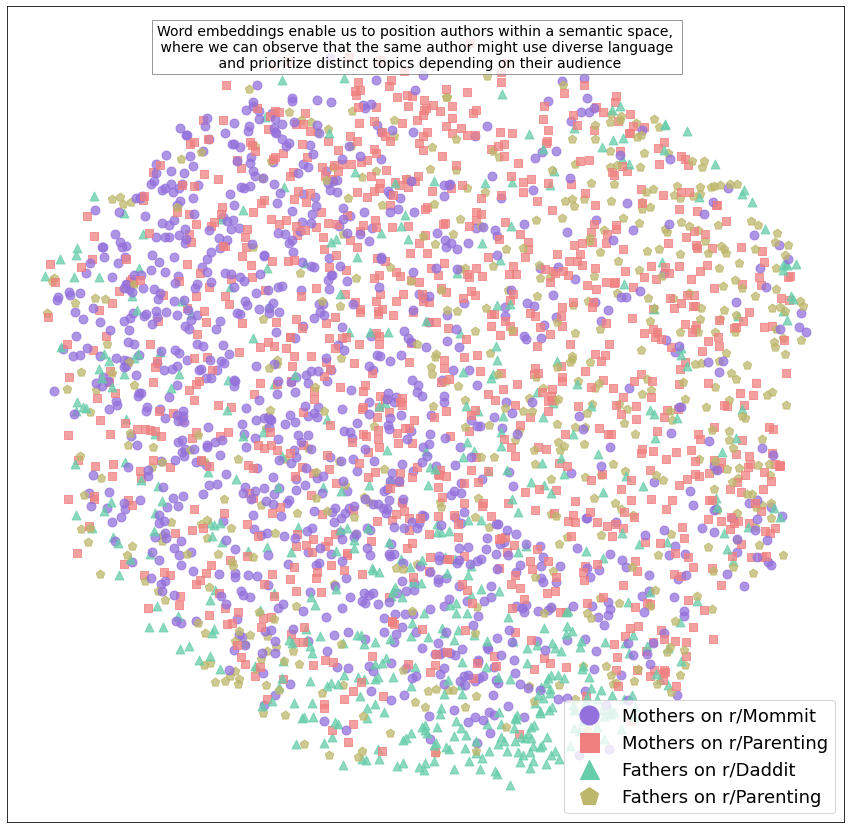

In [24]:
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.patches import Rectangle

# Create a figure and axis
fig, ax = plt.subplots(1, 1, figsize=(15, 15))

# Iterate through each color and marker combination
for i in range(len(umap_res_rand_pos)):
    ax.scatter(umap_res_rand_pos[i][0], umap_res_rand_pos[i][1], s=80, c=colours[i], marker=markers[i], alpha=0.75)

# Create custom legend items
custom_lines = []
for i in range(len(colours_plot)):
    custom_lines.append(Line2D([0], [0], marker=markers_plot[i], ls='', color=colours_plot[i], markersize=19))

# Add legend
ax.legend(custom_lines, ['Mothers on r/Mommit', 'Mothers on r/Parenting', 'Fathers on r/Daddit', 'Fathers on r/Parenting'],
          fontsize=13, loc="right", ncol=1, bbox_to_anchor=(1, 0.08), prop={'size': 18})

# Add text box with a colored background
text = ("Word embeddings enable us to position authors within a semantic space, \n where we can observe that the same author might use diverse language \n and prioritize distinct topics depending on their audience")
textbox = ax.text(0.49, 0.95, text, transform=ax.transAxes, va='center', ha='center', fontsize=14, color='black')

# Add a colored background to the text box
textbox.set_bbox(dict(facecolor='white', alpha=0.8, edgecolor='grey'))

# Remove ticks and labels
plt.tick_params(
    which='both',
    bottom=False,
    top=False,
    labelbottom=False,
    left=False,
    right=False,
    labelleft=False)

# Save and show the plot
plt.savefig("graphical_abstract.png", bbox_inches='tight', dpi=1200)
plt.show()


In [25]:
#visualise the landscape with topic keywords
#fig, ax = plt.subplots(1, 1, figsize=(15,15))

#ax.scatter([p[0] for p in umap_res_rand_pos], [p[1] for p in umap_res_rand_pos], s=80, c=colours, alpha = 0.75)
from matplotlib.pyplot import figure

figure(figsize=(13, 10), dpi=1200)

custom_lines = []
for i in range(4, len(colours_plot_2)):
        custom_lines.append(Patch(edgecolor="black", facecolor=colours_plot_2[i]))

plt.legend(custom_lines, list_topics, fontsize=17, loc="lower right", ncol= 1,
          bbox_to_anchor=(1.47,0.2), prop={'size': 17})
plt.rcParams['legend.title_fontsize'] = 'larger'


texts = []
for idx, word in enumerate(topics_keywords):
      texts.append(plt.text(ann_keyword_rand_pos[idx, 0], ann_keyword_rand_pos[idx, 1], word, fontsize=17, color="black", alpha = 0.9,
                            bbox=dict(boxstyle="round", ec="black", fc=col_topics[idx], alpha=0.8))) 
x_coordinates = [a[0] for a in ann_keyword_rand_pos]
y_coordinates = [a[1] for a in ann_keyword_rand_pos]

plt.scatter(x_coordinates, y_coordinates, edgecolors='black', c="black")
plt.axis()
plt.tick_params(
    which='both',      # both major and minor ticks are affected
    bottom=False,      # ticks along the bottom edge are off
    top=False,         # ticks along the top edge are off
    labelbottom=False, # labels along the bottom edge are off
    left=False,
    right=False,
    labelleft=False)

adjust_text(texts, x_coordinates, y_coordinates, arrowprops=dict(arrowstyle="-", color='k', lw=0.4))
plt.savefig("Figure4_topics_keywords.png", bbox_inches='tight')
plt.show()

# SIMILARITY BETWEEN USERS

In [26]:
#create 4 lists with the agents in each group
daddit_fathers = []
mommit_mothers = []
parenting_fathers = []
parenting_mothers = []

for i in range(len(sample_rand_pos)):
    if sample_rand_pos["agent"][i][-3:] == "_mm":
        mommit_mothers.append(sample_rand_pos["agent"][i])
    elif sample_rand_pos["agent"][i][-3:] == "_mp":
        parenting_mothers.append(sample_rand_pos["agent"][i])
    if sample_rand_pos["agent"][i][-3:] == "_fd":
        daddit_fathers.append(sample_rand_pos["agent"][i])
    if sample_rand_pos["agent"][i][-3:] == "_fp":
        parenting_fathers.append(sample_rand_pos["agent"][i])

#check the length
print("daddit_fathers", len(daddit_fathers))
print("mommit_mothers", len(mommit_mothers))
print("parenting_fathers", len(parenting_fathers))
print("parenting_mothers",len(parenting_mothers))

daddit_fathers 480
mommit_mothers 956
parenting_fathers 480
parenting_mothers 956


In [27]:
#similarity (pairwise and with centroid) between users in the same group
def similarity_groups(group, embedding):
    similarities = []
    for agent1 in group:
        for agent2 in group:
            if agent1 != agent2:
                similarities.append(embedding.similarity(agent1,agent2))
    
    similarities_mean = np.mean(similarities)
    similarities_sd = np.std(similarities)
    print(f"Average similarity {group[0][-2:]}: ", similarities_mean)
    print(f"Std similarity {group[0][-2:]}: ", similarities_sd)
    
    #centroid_group = np.average([embedding[agent] for agent in group], axis=0)
    
    #similarities_centroid = []
    
    #for agent in group:
    #    similarities_centroid.append(np.dot(embedding[agent], centroid_group))
    
    #similarities_centroid_mean = np.mean(similarities_centroid)
    #similarities_centroid_sd = np.std(similarities_centroid)
    
    #print(f"Average distance to centroid {group[0][-2:]}: ", similarities_centroid_mean)
    #print(f"Std distance to centroid {group[0][-2:]}:  ", similarities_centroid_sd, "\n\n")
    
    return similarities, similarities_mean, similarities_sd

print("Fathers on r/Daddit: \n")
fd_similarities, fd_rand_similarities_mean, fd_rand_similarities_sd = similarity_groups(daddit_fathers, embedding_rand_agent)
print("\nMothers on r/Mommit: \n")
mm_similarities, mm_rand_similarities_mean, mm_rand_similarities_sd = similarity_groups(mommit_mothers, embedding_rand_agent)
print("\nFathers on r/Parenting: \n")
fp_similarities, fp_rand_similarities_mean, fp_rand_similarities_sd = similarity_groups(parenting_fathers, embedding_rand_agent)
print("\nMothers on r/Parenting: \n")
mp_similarities, mp_rand_similarities_mean, mp_rand_similarities_sd = similarity_groups(parenting_mothers, embedding_rand_agent)

Fathers on r/Daddit: 

Average similarity fd:  0.3012657
Std similarity fd:  0.10883411

Mothers on r/Mommit: 

Average similarity mm:  0.27692187
Std similarity mm:  0.10452581

Fathers on r/Parenting: 

Average similarity fp:  0.20253128
Std similarity fp:  0.08852016

Mothers on r/Parenting: 

Average similarity mp:  0.18764447
Std similarity mp:  0.08537171


In [28]:
#create a dataframe for visualisation
dict_sim_rand = {
    'group': ["Mothers on r/Mommit", "Mothers on r/Parenting", "Fathers on r/Daddit", "Fathers on r/Parenting"],
    'average_similarity': [mm_rand_similarities_mean, mp_rand_similarities_mean, fd_rand_similarities_mean, fp_rand_similarities_mean],
    'std': [mm_rand_similarities_sd, mp_rand_similarities_sd, fd_rand_similarities_sd, fp_rand_similarities_sd]
}

sim_groups_rand = pd.DataFrame(dict_sim_rand)
sim_groups_rand

,group,average_similarity,std
0,Mothers on r/Mommit,0.276922,0.104526
1,Mothers on r/Parenting,0.187644,0.085372
2,Fathers on r/Daddit,0.301266,0.108834
3,Fathers on r/Parenting,0.202531,0.088520


In [29]:
#convert to np.array for K-S tests
mommit_sim = np.array(mm_similarities)
daddit_sim = np.array(fd_similarities)
momparent_sim = np.array(mp_similarities)
dadparent_sim = np.array(fp_similarities)

In [30]:
plt.figure(figsize=(12, 8), dpi=1200) 

# Define line styles for each group
line_styles = ['-', '--', '-.', ':']

# Plot the distributions with different line styles
sns.distplot(momparent_sim, color="lightcoral", hist=False, label="Mothers on r/Parenting", kde_kws={'linestyle': line_styles[0]})
sns.distplot(dadparent_sim, color="darkkhaki", hist=False, label="Fathers on r/Parenting", kde_kws={'linestyle': line_styles[1]})
sns.distplot(mommit_sim, color="mediumpurple", hist=False, label="Mothers on r/Mommit", kde_kws={'linestyle': line_styles[2]})
sns.distplot(daddit_sim, color="mediumaquamarine", hist=False, label="Fathers on r/Daddit", kde_kws={'linestyle': line_styles[3]})

plt.legend(loc="best", fontsize='large')
plt.xlabel('Cosine similarity')
plt.savefig("Figure2_similarity_within_groups_agent_rand.png", bbox_inches='tight')
plt.show()

/Users/melodysepahpour/miniforge3/envs/mlp/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/Users/melodysepahpour/miniforge3/envs/mlp/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).
  warnings.warn(msg, FutureWarning)
/Users/melodysepahpour/miniforge3/envs/mlp/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code

In [31]:
#see if two samples come from the same distribution
from scipy.stats import ks_2samp

#perform Kolmogorov-Smirnov test
print("comparison daddit fathers/mommit mothers:\n")
print(ks_2samp(daddit_sim, mommit_sim))

print("\ncomparison parenting fathers/mommit mothers:\n")
print(ks_2samp(mommit_sim, dadparent_sim))

print("\ncomparison mommit mothers/parenting mothers:\n")
print(ks_2samp(mommit_sim, momparent_sim))

print("\ncomparison daddit fathers/parenting mothers:\n")
print(ks_2samp(daddit_sim, momparent_sim))

print("\ncomparison parenting fathers/daddit fathers:\n")
print(ks_2samp(daddit_sim, dadparent_sim))

print("\ncomparison parenting fathers/parenting mothers:\n")
print(ks_2samp(dadparent_sim, momparent_sim))

comparison daddit fathers/mommit mothers:

KstestResult(statistic=0.09343672459545138, pvalue=0.0)

comparison parenting fathers/mommit mothers:

KstestResult(statistic=0.31084187125833374, pvalue=0.0)

comparison mommit mothers/parenting mothers:

KstestResult(statistic=0.37192052399833514, pvalue=0.0)

comparison daddit fathers/parenting mothers:

KstestResult(statistic=0.4493963720905515, pvalue=0.0)

comparison parenting fathers/daddit fathers:

KstestResult(statistic=0.39211029923451635, pvalue=0.0)

comparison parenting fathers/parenting mothers:

KstestResult(statistic=0.06925678206461572, pvalue=0.0)


# SIMILARITY BETWEEN 2 VERSIONS OF THE SAME USER

In [32]:
#create 2 lists for mothers and fathers
mom_to_keep = list(set([ag[:-3] for ag in sample_rand_pos["agent"] if ag[-2] == 'm']))
dad_to_keep = list(set([ag[:-3] for ag in sample_rand_pos["agent"] if ag[-2] == 'f']))

#for mothers
mothers_lists = []
for mother in list(mom_to_keep):
    mothers_lists.append([mother+'_mm', mother+'_mp'])

print(len(mothers_lists))

#for fathers
fathers_lists = []
for father in list(dad_to_keep):
    fathers_lists.append([father+'_fd', father+'_fp'])

print(len(fathers_lists))

956
480


In [33]:
#similarity between two versions of agents - mothers
mom_sim_rand = []
for mom in mothers_lists:
    mom_sim_rand.append(embedding_rand_agent.similarity(mom[0], mom[1]))

sim_mom_mean_rand = np.mean(mom_sim_rand)
sim_mom_sd_rand = np.std(mom_sim_rand)
print(sim_mom_mean_rand)
print(sim_mom_sd_rand)

0.32603908
0.106123276


In [34]:
sim_mom_q1_rand = np.percentile(mom_sim_rand, 25)
sim_mom_q3_rand = np.percentile(mom_sim_rand, 75)
print(sim_mom_q1_rand)
print(sim_mom_q3_rand)

0.25345470011234283
0.3902984708547592


In [35]:
#similarity between two versions of agents - fathers
dad_sim_rand = []
for dad in fathers_lists:
    dad_sim_rand.append(embedding_rand_agent.similarity(dad[0], dad[1]))

sim_dad_mean_rand = np.mean(dad_sim_rand)
sim_dad_sd_rand = np.std(dad_sim_rand)
print(sim_dad_mean_rand)
print(sim_dad_sd_rand)

0.33525714
0.11484732


In [36]:
sim_dad_q1_rand = np.percentile(dad_sim_rand, 25)
sim_dad_q3_rand = np.percentile(dad_sim_rand, 75)
print(sim_dad_q1_rand)
print(sim_dad_q3_rand)

0.25576309859752655
0.4035055860877037


In [37]:
#Visualise the within agent similarity and compare genders
plt.figure(figsize=(12, 8), dpi=1200) 
data_dad_sim = np.array(dad_sim_rand)
data_mom_sim = np.array(mom_sim_rand)

#fig, ax = plt.subplots(1,2, figsize=(15,7))
sns.distplot(data_dad_sim, color="green", kde_kws={'linestyle': "-", 'color': "green"}, bins=50, label="Fathers")
sns.distplot(data_mom_sim, color="purple", kde_kws={'linestyle': "--", 'color': "purple"}, bins=50, label="Mothers")

# Create custom legend lines and labels
custom_lines = [Line2D([0], [0], color='green', linestyle="-", lw=2),
                Line2D([0], [0], color='purple', linestyle="--", lw=2)]

# Set legend labels using custom legend lines
plt.legend(custom_lines, ['Fathers', 'Mothers'])

plt.xlabel('Cosine similarity')
plt.savefig("Figure3_similarity_2versions_parents_distrib.png", bbox_inches='tight')
plt.show()

/Users/melodysepahpour/miniforge3/envs/mlp/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
/Users/melodysepahpour/miniforge3/envs/mlp/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


In [38]:
#compare the 2 distributions using K-S test
ks_2samp(data_mom_sim, data_dad_sim)

KstestResult(statistic=0.04911087866108787, pvalue=0.4068443390242526)

# SIMILARITY BETWEEN TOPICS AND GROUPS

In [39]:
#create lists of selected keywords and combine them in a dictionary

topics_keywords_lists = [
    ["thank", "word", "thanks", "advice", "moment", "hug"], 
    ["doctor", "hospital", "anxiety", "pain", "risk", "health"], 
    ["situation", "family", "relationship", "problem", "issue", "behavior"], 
    ["room", "floor", "door", "house", "bathroom", "space"], 
    ["life", "love", "partner", "pregnancy", "heart", "birth"], 
    ["diaper", "body", "sex",  "potty", "poop", "toilet"], 
    ["dog", "look", "face", "eye", "picture", "memory"], 
    ["home", "car", "work", "house", "job", "money"], 
    ["food", "water", "meal", "milk", "snack", "dinner"], 
    ["book", "game", "play", "attention",  "activity", "fun"], 
    ["school", "teacher", "class", "daycare", "language","college"], 
    ["night", "bed", "sleep", "nap", "bedtime", "schedule"]
]

topics_with_keywords = dict()

for i in range(len(list_topics)): 
    key = list_topics[i]
    val = topics_keywords_lists[i]
    topics_with_keywords[key] = val

In [40]:
topics_keywords_lists[0]

['thank', 'word', 'thanks', 'advice', 'moment', 'hug']

In [41]:
def zip_with_scalar(l, o):
    return zip(l, itertools.repeat(o))

#find the centroid of agents and the centroid of topics and measure their similarity
def centroid(group, embedding): 
    return np.mean([embedding[token] for token in group], axis=0)

def create_dict_similarity(list_of_agents_in_groups, topics_keywords_lists, topics_list, names_groups, embedding):
    final_dict = {
        #"agents": [],
        "agents_group": [],
        "topic": [],
        "similarity": [], 
    }
    #topics_centroids = [centroid(topic, embedding) for topic in topics_keywords_lists]

    for i in range(len(list_of_agents_in_groups)): 
        agents = list_of_agents_in_groups[i]
        for j in range(len(topics_keywords_lists)):
            keywords = topics_keywords_lists[j]
            for agent in agents:
                #final_dict["agents"].append(agent)
                agent_topic_mean = np.mean([(np.dot(embedding[keyword], embedding[agent])/(np.linalg.norm(embedding[keyword])* np.linalg.norm(embedding[agent]))) for keyword in keywords])
                final_dict["topic"].append(topics_list[j])
                final_dict["similarity"].append(agent_topic_mean)
                final_dict["agents_group"].append(names_groups[i])
    
    return pd.DataFrame(final_dict)

topics_groups_similarity = create_dict_similarity([daddit_fathers, parenting_fathers, mommit_mothers, parenting_mothers], topics_keywords_lists, list_topics, ["Fathers on r/Daddit", "Fathers on r/Parenting", "Mothers on r/Mommit", "Mothers on r/Parenting"], embedding_rand_agent)
topics_groups_similarity.head()

,agents_group,topic,similarity
0,Fathers on r/Daddit,Thank you/Appreciation,0.137618
1,Fathers on r/Daddit,Thank you/Appreciation,0.170031
2,Fathers on r/Daddit,Thank you/Appreciation,0.183809
3,Fathers on r/Daddit,Thank you/Appreciation,0.184567
4,Fathers on r/Daddit,Thank you/Appreciation,0.186561


In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming you have a DataFrame called 'df' with columns: 'authors', 'group', 'topic', and 'cosine_similarity'

# Set the size of the figure
plt.figure(figsize=(12, 8), dpi=1200) 

flierprops = dict(markerfacecolor='0.75', markersize=2,
              linestyle='none')

# Create a grouped boxplot using seaborn
sns.boxplot(x='topic', y='similarity', hue='agents_group', data=topics_groups_similarity, palette='Set3', flierprops=flierprops)

# Set the axis labels and title
plt.xlabel('Topic')
plt.ylabel('Cosine Similarity')
plt.title('Cosine Similarity between Topics and Groups')

# Rotate the x-axis labels for better visibility if needed
plt.xticks(rotation=45, ha="right")

# Display the plot
plt.savefig("Figure5_grouped_boxplot_allgroups.png", bbox_inches='tight')
plt.show()


In [43]:
import seaborn as sns
import matplotlib.pyplot as plt

custom_palette = ["mediumaquamarine", "darkkhaki", "mediumpurple", "lightcoral"]

# Set the size of the figure
plt.figure(figsize=(12, 8), dpi=1200) 

flierprops = dict(markerfacecolor='0.75', markersize=2,
              linestyle='none')

# Create a grouped boxplot using seaborn
ax = sns.boxplot(x='topic', y='similarity', hue='agents_group', data=topics_groups_similarity, palette=colours_plot, flierprops=flierprops)

# Set the axis labels and title
ax.set_xlabel('Topic')
ax.set_ylabel('Cosine Similarity')
#ax.set_title('Cosine Similarity between Topics and Groups')

# Rotate the x-axis labels for better visibility if needed
plt.xticks(rotation=45, ha="right")

# Remove the legend title
ax.get_legend().set_title('')

# Display the plot
plt.savefig("Figure5_grouped_boxplot_allgroups.png", bbox_inches='tight')
plt.show()


In [44]:
import scipy.stats as stats
from itertools import combinations

# Assuming you have a DataFrame called 'df' with columns: 'authors', 'group', 'topic', and 'cosine_similarity'

# Create an empty DataFrame to store the t-test results
ttest_results = pd.DataFrame(columns=['Topic', 'Group 1', 'Group 2', 'T-Statistic', 'P-Value'])

# Perform t-tests for each topic
topics = topics_groups_similarity['topic'].unique()

# Generate all pairwise combinations of groups
groups = topics_groups_similarity['agents_group'].unique()
group_combinations = list(combinations(groups, 2))

for topic in topics:
    topic_data = topics_groups_similarity[topics_groups_similarity['topic'] == topic]
    
    # Perform t-test for each pairwise combination of groups
    for combination in group_combinations:
        group1 = combination[0]
        group2 = combination[1]
        group1_data = topic_data[topic_data['agents_group'] == group1]['similarity']
        group2_data = topic_data[topic_data['agents_group'] == group2]['similarity']
        
        # Perform t-test
        statistic, p_value = stats.ttest_ind(group1_data, group2_data)
        
        # Append the t-test results to the DataFrame
        ttest_results = ttest_results.append({
            'Topic': topic,
            'Group 1': group1,
            'Group 2': group2,
            'T-Statistic': statistic,
            'P-Value': p_value
        }, ignore_index=True)

# Display the t-test results table
ttest_results.head()

/var/folders/hh/5478tq9n4_79_h197kc83gqh0000gn/T/ipykernel_15474/3032436844.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ttest_results = ttest_results.append({
/var/folders/hh/5478tq9n4_79_h197kc83gqh0000gn/T/ipykernel_15474/3032436844.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ttest_results = ttest_results.append({
/var/folders/hh/5478tq9n4_79_h197kc83gqh0000gn/T/ipykernel_15474/3032436844.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ttest_results = ttest_results.append({
/var/folders/hh/5478tq9n4_79_h197kc83gqh0000gn/T/ipykernel_15474/3032436844.py:30: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  ttest_resul

,Topic,Group 1,Group 2,T-Statistic,P-Value
0,Thank you/Appreciation,Fathers on r/Daddit,Fathers on r/Parenting,7.218036,0.0
1,Thank you/Appreciation,Fathers on r/Daddit,Mothers on r/Mommit,4.408043,0.000011
2,Thank you/Appreciation,Fathers on r/Daddit,Mothers on r/Parenting,10.827469,0.0
3,Thank you/Appreciation,Fathers on r/Parenting,Mothers on r/Mommit,-4.047478,0.000055
4,Thank you/Appreciation,Fathers on r/Parenting,Mothers on r/Parenting,2.609103,0.009172


In [45]:
sim_mom_10_rand = np.percentile(mom_sim_rand, 10)
sim_mom_90_rand = np.percentile(mom_sim_rand, 90)
print(sim_mom_10_rand)
print(sim_mom_90_rand)

0.19645098596811295
0.45739081501960754


In [46]:
def zip_with_scalar(l, o):
    return zip(l, itertools.repeat(o))

#find the centroid of agents and the centroid of topics and measure their similarity
def centroid(group, embedding): 
    return np.mean([embedding[token] for token in group], axis=0)

def create_dict_similarity_centroids(list_of_agents_in_groups, topics_keywords_lists, topics_list, names_groups, embedding):
    final_dict = {
        #"agents": [],
        "agents_group": [],
        "topic": [],
        "similarity": [], 
    }
    topics_centroids = [centroid(topic, embedding) for topic in topics_keywords_lists]
    groups_centroids = [centroid(group, embedding) for group in list_of_agents_in_groups]

    for i in range(len(groups_centroids)): 
        group_centroid = groups_centroids[i]
        for j in range(len(topics_centroids)):
            topic_centroid = topics_centroids[j]
            final_dict["topic"].append(topics_list[j])
            final_dict["similarity"].append(np.dot(group_centroid, topic_centroid)/(np.linalg.norm(group_centroid)* np.linalg.norm(topic_centroid)))
            final_dict["agents_group"].append(names_groups[i])
    
    return pd.DataFrame(final_dict)

topics_groups_similarity_centroid = create_dict_similarity_centroids([daddit_fathers, parenting_fathers, mommit_mothers, parenting_mothers], topics_keywords_lists, list_topics, ["Fathers on r/Daddit", "Fathers on r/Parenting", "Mothers on r/Mommit", "Mothers on r/Parenting"], embedding_rand_agent)
topics_groups_similarity_centroid.head()

,agents_group,topic,similarity
0,Fathers on r/Daddit,Thank you/Appreciation,0.576153
1,Fathers on r/Daddit,Medical care,0.453094
2,Fathers on r/Daddit,Education/Family advice,0.430477
3,Fathers on r/Daddit,Furniture/Design,0.443646
4,Fathers on r/Daddit,Birth/Pregnancy,0.584585


In [47]:
# #visualise similarity between topics and groups
# colours_plot_centroid = ["mediumpurple", "lightcoral", "mediumaquamarine", "darkkhaki"]

# # make facetgrid and store in variable
# g = sns.FacetGrid(topics_groups_similarity_centroid, col='topic', col_wrap=4, height=6, aspect= 1) # make facetgrid with 2 columns, because there are two distinct values in column a of data
# g.map_dataframe(plt.bar, 'agents_group', 'similarity', color=colours_plot_centroid) # map function to grid

# g.set_ylabels("Average similarity with topic", size=20)
# g.set_titles(size=20)
# g.set_xlabels(size=20)
# g.set_xticklabels(rotation=45, ha='right', size=20)

# plt.subplots_adjust(hspace = 0.2, wspace = 0.4)

# plt.savefig("alltopics_similarity_groups_centroid.png", bbox_inches='tight')

In [48]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Set the colors for each group
# colours_plot_centroid = ["mediumpurple", "lightcoral", "mediumaquamarine", "darkkhaki"]

# # Set the figure size
# plt.figure(figsize=(12, 8))

# # Create a bar plot for each topic using a FacetGrid
# g = sns.FacetGrid(topics_groups_similarity_centroid, col='topic', col_wrap=4, height=6, aspect=1)

# # Define the function to plot the bar plot
# def plot_barplot(data, **kwargs):
#     sns.barplot(data=data, x='agents_group', y='similarity', palette=colours_plot_centroid)
#     plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels

# # Map the bar plot function to each facet
# g.map_dataframe(plot_barplot)

# # Set the labels and titles
# g.set_axis_labels("Agent Group", "Average Similarity with Topic")
# g.set_titles("{col_name}")

# # Adjust the spacing between subplots
# plt.subplots_adjust(hspace=0.2, wspace=0.4)

# # Save the plot
# plt.savefig("alltopics_similarity_groups_centroid.png", bbox_inches='tight')

# # Show the plot
# plt.show()

In [49]:
mothers_lists_similarities = list(zip(mothers_lists, mom_sim_rand))

In [50]:
fathers_lists_similarities = list(zip(fathers_lists, dad_sim_rand))

In [51]:
mothers_lists_most_similar = []
mothers_lists_least_similar = []
for mother in mothers_lists_similarities: 
    if mother[1] >= sim_mom_q3_rand: 
        mothers_lists_most_similar.append(mother)
    elif mother[1] <= sim_mom_q1_rand:
        mothers_lists_least_similar.append(mother)

In [52]:
fathers_lists_most_similar = []
fathers_lists_least_similar = []
for father in fathers_lists_similarities: 
    if father[1] >= sim_dad_q3_rand: 
        fathers_lists_most_similar.append(father)
    elif father[1] <= sim_dad_q1_rand:
        fathers_lists_least_similar.append(father)

In [53]:
print(len(fathers_lists_most_similar))
print(len(fathers_lists_least_similar))

120
120


In [54]:
print(len(mothers_lists_most_similar))
print(len(mothers_lists_least_similar))

239
239


In [55]:
mothers_mommit_most_similar = [mother[0][0] for mother in mothers_lists_most_similar]
mothers_parenting_most_similar = [mother[0][1] for mother in mothers_lists_most_similar]
mothers_mommit_least_similar = [mother[0][0] for mother in mothers_lists_least_similar]
mothers_parenting_least_similar = [mother[0][1] for mother in mothers_lists_least_similar]

print(mothers_mommit_most_similar[:5])
print(mothers_parenting_most_similar[:5])
print(mothers_mommit_least_similar[:5])
print(mothers_parenting_least_similar[:5])

['agent_grayandlizzie_mm', 'agent_DryStore6_mm', 'agent_CrankyIvysaur_mm', 'agent_VaBookworm_mm', 'agent_Hahapants4u_mm']
['agent_grayandlizzie_mp', 'agent_DryStore6_mp', 'agent_CrankyIvysaur_mp', 'agent_VaBookworm_mp', 'agent_Hahapants4u_mp']
['agent_CucumberJulep_mm', 'agent_fgn15_mm', 'agent_WillOnlyGoUp_mm', 'agent_Vonnybon_mm', 'agent_skateswithdolphins_mm']
['agent_CucumberJulep_mp', 'agent_fgn15_mp', 'agent_WillOnlyGoUp_mp', 'agent_Vonnybon_mp', 'agent_skateswithdolphins_mp']


In [56]:
fathers_daddit_most_similar = [father[0][0] for father in fathers_lists_most_similar]
fathers_parenting_most_similar = [father[0][1] for father in fathers_lists_most_similar]
fathers_daddit_least_similar = [father[0][0] for father in fathers_lists_least_similar]
fathers_parenting_least_similar = [father[0][1] for father in fathers_lists_least_similar]

print(fathers_daddit_most_similar[:5])
print(fathers_parenting_most_similar[:5])
print(fathers_daddit_least_similar[:5])
print(fathers_parenting_least_similar[:5])

['agent_kindsoberfullydressd_fd', 'agent_mberrong_fd', 'agent_Independent-Eggplant_fd', 'agent_esengo_fd', 'agent_Piratey_Pirate_fd']
['agent_kindsoberfullydressd_fp', 'agent_mberrong_fp', 'agent_Independent-Eggplant_fp', 'agent_esengo_fp', 'agent_Piratey_Pirate_fp']
['agent_RayWeil_fd', 'agent_KazoBanjooie64_fd', 'agent_ImpatientTurtle_fd', 'agent_ezshucks_fd', 'agent_battlerazzle01_fd']
['agent_RayWeil_fp', 'agent_KazoBanjooie64_fp', 'agent_ImpatientTurtle_fp', 'agent_ezshucks_fp', 'agent_battlerazzle01_fp']


In [57]:
topics_groups_similarity_mothers_mostleast_similar = create_dict_similarity([mothers_mommit_most_similar, mothers_mommit_least_similar, mothers_parenting_most_similar, mothers_parenting_least_similar], topics_keywords_lists, list_topics, ["Low self-monitoring mothers on r/Mommit", "High self-monitoring mothers on r/Mommit", "Low self-monitoring mothers on r/Parenting", "High self-monitoring mothers on r/Parenting"], embedding_rand_agent)
topics_groups_similarity_mothers_mostleast_similar.head()

,agents_group,topic,similarity
0,Low self-monitoring mothers on r/Mommit,Thank you/Appreciation,0.162942
1,Low self-monitoring mothers on r/Mommit,Thank you/Appreciation,0.220224
2,Low self-monitoring mothers on r/Mommit,Thank you/Appreciation,0.248246
3,Low self-monitoring mothers on r/Mommit,Thank you/Appreciation,0.177394
4,Low self-monitoring mothers on r/Mommit,Thank you/Appreciation,0.140303


In [58]:
topics_groups_similarity_fathers_mostleast_similar = create_dict_similarity([fathers_daddit_most_similar, fathers_daddit_least_similar, fathers_parenting_most_similar, fathers_parenting_least_similar], topics_keywords_lists, list_topics, ["Low self-monitoring fathers on r/Daddit", "High self-monitoring fathers on r/Daddit", "Low self-monitoring fathers on r/Parenting", "High self-monitoring fathers on r/Parenting"], embedding_rand_agent)
topics_groups_similarity_fathers_mostleast_similar.head()

,agents_group,topic,similarity
0,Low self-monitoring fathers on r/Daddit,Thank you/Appreciation,0.160339
1,Low self-monitoring fathers on r/Daddit,Thank you/Appreciation,0.202806
2,Low self-monitoring fathers on r/Daddit,Thank you/Appreciation,0.244285
3,Low self-monitoring fathers on r/Daddit,Thank you/Appreciation,0.275014
4,Low self-monitoring fathers on r/Daddit,Thank you/Appreciation,0.139290


In [59]:
# Define a custom color palette with red, pink, and purple colors
custom_palette = ["#FBB4AE", "#5E3C99", "#FFA500", "#990000"]

# Set the size of the figure
plt.figure(figsize=(12, 8), dpi=1200) 

flierprops = dict(markerfacecolor='0.75', markersize=2,
              linestyle='none')

# Create a grouped boxplot using seaborn and the custom color palette
sns.boxplot(x='topic', y='similarity', hue='agents_group', data=topics_groups_similarity_mothers_mostleast_similar, palette=custom_palette, flierprops=flierprops)

# Set the axis labels and title
plt.xlabel('Topic')
plt.ylabel('Cosine Similarity')
#plt.title('Variability of Cosine Similarity across Topics and Groups')

# Rotate the x-axis labels for better visibility if needed
plt.xticks(rotation=45, ha="right")

# Remove the legend title
plt.legend(title=None)

# Display the plot
plt.savefig("Figure6_grouped_boxplot_mothers.png", bbox_inches='tight')
plt.show()


In [60]:
# Define a custom color palette with dark green, light green, brown, and yellow colors
custom_palette = ["#00FF00", "#006400", "#FFD700", "#B8860B"]

# Set the size of the figure
plt.figure(figsize=(12, 8), dpi=1200) 

flierprops = dict(markerfacecolor='0.75', markersize=2,
              linestyle='none')

# Create a grouped boxplot using seaborn and the custom color palette
sns.boxplot(x='topic', y='similarity', hue='agents_group', data=topics_groups_similarity_fathers_mostleast_similar, palette=custom_palette, flierprops=flierprops)

# Set the axis labels and title
plt.xlabel('Topic')
plt.ylabel('Cosine Similarity')
#plt.title('Variability of Cosine Similarity across Topics and Groups')

# Rotate the x-axis labels for better visibility if needed
plt.xticks(rotation=45, ha="right")

# Remove the legend title
plt.legend(title=None)

# Display the plot
plt.savefig("Figure7_grouped_boxplot_fathers.png", bbox_inches='tight')
plt.show()

In [80]:
# #create a dataframe combining topics, group, and similarity measures
# mothers_mommit_most_similar_topics_dist_with_topics = list(zip(mothers_mommit_most_similar_topics_dist, list_topics))
# mothers_parenting_most_similar_topics_dist_with_topics = list(zip(mothers_parenting_most_similar_topics_dist, list_topics))
# mothers_mommit_least_similar_topics_dist_with_topics = list(zip(mothers_mommit_least_similar_topics_dist, list_topics))
# mothers_parenting_least_similar_topics_dist_with_topics = list(zip(mothers_parenting_least_similar_topics_dist, list_topics))

# groups_similarity_mothers = [mothers_mommit_most_similar_topics_dist_with_topics, mothers_parenting_most_similar_topics_dist_with_topics, 
#                      mothers_mommit_least_similar_topics_dist_with_topics, mothers_parenting_least_similar_topics_dist_with_topics]

# all_topics_groups_similarity_mothers = {"topic": [],
#                                "similarity": [],
#                                "group": []}
# for group in groups_similarity_mothers:
#     for topic in group: 
#         if group == groups_similarity_mothers[0]:
#             all_topics_groups_similarity_mothers["group"].append("Mothers on r/Mommit most similar")
#         elif group == groups_similarity_mothers[1]:
#             all_topics_groups_similarity_mothers["group"].append("Mothers on r/Parenting most similar")
#         elif group == groups_similarity_mothers[2]:
#             all_topics_groups_similarity_mothers["group"].append("Mothers on r/Mommit least similar")
#         elif group == groups_similarity_mothers[3]:
#             all_topics_groups_similarity_mothers["group"].append("Mothers on r/Parenting least similar")
#         all_topics_groups_similarity_mothers['topic'].append(topic[1])
#         all_topics_groups_similarity_mothers['similarity'].append(topic[0])

# all_topics_groups_similarity_mothers_df = pd.DataFrame(all_topics_groups_similarity_mothers)

In [81]:
# #create a dataframe combining topics, group, and similarity measures
# fathers_daddit_most_similar_topics_dist_with_topics = list(zip(fathers_daddit_most_similar_topics_dist, list_topics))
# fathers_parenting_most_similar_topics_dist_with_topics = list(zip(fathers_parenting_most_similar_topics_dist, list_topics))
# fathers_daddit_least_similar_topics_dist_with_topics = list(zip(fathers_daddit_least_similar_topics_dist, list_topics))
# fathers_parenting_least_similar_topics_dist_with_topics = list(zip(fathers_parenting_least_similar_topics_dist, list_topics))

# groups_similarity_fathers = [fathers_daddit_most_similar_topics_dist_with_topics, fathers_parenting_most_similar_topics_dist_with_topics, 
#                      fathers_daddit_least_similar_topics_dist_with_topics, fathers_parenting_least_similar_topics_dist_with_topics]

# all_topics_groups_similarity_fathers = {"topic": [],
#                                "similarity": [],
#                                "group": []}
# for group in groups_similarity_fathers:
#     for topic in group: 
#         if group == groups_similarity_fathers[0]:
#             all_topics_groups_similarity_fathers["group"].append("Fathers on r/Daddit most similar")
#         elif group == groups_similarity_fathers[1]:
#             all_topics_groups_similarity_fathers["group"].append("Fathers on r/Parenting most similar")
#         elif group == groups_similarity_fathers[2]:
#             all_topics_groups_similarity_fathers["group"].append("Fathers on r/Daddit least similar")
#         elif group == groups_similarity_fathers[3]:
#             all_topics_groups_similarity_fathers["group"].append("Fathers on r/Parenting least similar")
#         all_topics_groups_similarity_fathers['topic'].append(topic[1])
#         all_topics_groups_similarity_fathers['similarity'].append(topic[0])

# all_topics_groups_similarity_fathers_df = pd.DataFrame(all_topics_groups_similarity_fathers)

In [82]:
# #visualise similarity between topics and groups
# colours_plot = ['saddlebrown', 'mediumslateblue', 'thistle', 'sandybrown']

# # make facetgrid and store in variable
# g = sns.FacetGrid(all_topics_groups_similarity_mothers_df, col='topic', col_wrap=4, height=6, aspect= 1) # make facetgrid with 2 columns, because there are two distinct values in column a of data
# g.map_dataframe(plt.bar, 'group', 'similarity', color=colours_plot) # map function to grid

# g.set_ylabels("Average similarity with topic", size=20)
# g.set_titles(size=20)
# g.set_xlabels(size=20)
# g.set_xticklabels(rotation=45, ha='right', size=20)

# plt.subplots_adjust(hspace = 0.2, wspace = 0.4)

# plt.savefig("alltopics_similarity_groups_centroid.png", bbox_inches='tight')

In [83]:
# #visualise similarity between topics and groups
# colours_plot = ['saddlebrown', 'mediumslateblue', 'thistle', 'sandybrown']

# # make facetgrid and store in variable
# g = sns.FacetGrid(all_topics_groups_similarity_fathers_df, col='topic', col_wrap=4, height=6, aspect= 1) # make facetgrid with 2 columns, because there are two distinct values in column a of data
# g.map_dataframe(plt.bar, 'group', 'similarity', color=colours_plot) # map function to grid

# g.set_ylabels("Average similarity with topic", size=20)
# g.set_titles(size=20)
# g.set_xlabels(size=20)
# g.set_xticklabels(rotation=45, ha='right', size=20)

# plt.subplots_adjust(hspace = 0.2, wspace = 0.4)

# plt.savefig("alltopics_similarity_groups_centroid.png", bbox_inches='tight')